# Ocean Wave Data Exploration

This notebook demonstrates how to use the NDBC data processor and visualization tools.

**Author**: Josiah Panak
**Date**: August 2025  
**Purpose**: Exploratory data analysis of NOAA/NDBC wave data

## Setup

In [1]:
# Import libraries
import sys
sys.path.append('../src')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings

from data_processor import NDBCDataProcessor
from visualizations import WaveVisualizer, create_summary_figure

warnings.filterwarnings('ignore')

# Set plotting style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette('husl')

## 1. Data Loading

Load wave data from NOAA/NDBC stations.

In [2]:
# Initialize processor
processor = NDBCDataProcessor()

# List available stations
print("Available Stations:")
for station_id, name in processor.POPULAR_STATIONS.items():
    print(f"  {station_id}: {name}")

Available Stations:
  46042: Monterey Bay, CA
  44013: Boston, MA
  41002: South Hatteras, NC
  46006: Southeast Papa (Pacific)
  51001: Northwest Hawaii
  42001: Gulf of Mexico
  44025: Long Island, NY


In [3]:
# Fetch data
station_id = '44013'  # Boston, MA
year = 2024

print(f"Fetching data for station {station_id}, year {year}...")
raw_data, station = processor.try_multiple_stations(year=year)

if raw_data is not None:
    print(f"\nSuccessfully loaded {len(raw_data)} rows")
    print(f"Station: {station}")
else:
    print("Failed to load data")

Fetching data for station 44013, year 2024...
Fetching 2024 data from station 46042...
No data available for 46042 in 2024
Fetching 2024 data from station 44013...
Successfully fetched 52665 rows for year 2024
Successfully got data from station 44013

Successfully loaded 52665 rows
Station: 44013


## 2. Data Processing

Clean and process the raw data.

In [4]:
# Process data
if raw_data is not None:
    data = processor.clean_and_process(raw_data)
    
    # Display basic info
    print("\nData Shape:", data.shape)
    print("\nDate Range:")
    print(f"  Start: {data.index.min()}")
    print(f"  End: {data.index.max()}")
    print(f"  Duration: {(data.index.max() - data.index.min()).days} days")
    
    print("\nAvailable Variables:")
    print(data.columns.tolist())

Cleaning and processing data...
Processed 52665 records

Data Shape: (52665, 28)

Date Range:
  Start: 2024-01-01 00:00:00
  End: 2024-12-31 23:50:00
  Duration: 365 days

Available Variables:
['YY', 'MM', 'DD', 'hh', 'mm', 'wind_dir', 'wind_speed', 'gust_speed', 'Hs', 'Tp', 'Tm', 'Dp', 'pressure', 'air_temp', 'water_temp', 'DEWP', 'VIS', 'TIDE', 'wavelength', 'steepness', 'wave_type', 'month', 'day_of_year', 'hour', 'season', 'season_name', 'storm_flag', 'qc_flag']


In [5]:
# Display first few rows
data[['Hs', 'Tp', 'Tm', 'wind_speed', 'pressure', 'steepness', 'wave_type']].head(10)

,Hs,Tp,Tm,wind_speed,pressure,steepness,wave_type
datetime,,,,,,,
2024-01-01 00:00:00,99.00,99.00,99.00,5.3,1014.6,0.006470,SWELL
2024-01-01 00:10:00,0.58,12.12,3.29,5.9,1014.5,0.002529,SWELL
2024-01-01 00:20:00,99.00,99.00,99.00,6.4,1014.5,0.006470,SWELL
2024-01-01 00:30:00,99.00,99.00,99.00,6.5,1014.6,0.006470,SWELL
2024-01-01 00:40:00,0.61,2.74,3.15,6.6,1014.8,0.052040,STEEP
2024-01-01 00:50:00,99.00,99.00,99.00,6.1,1014.6,0.006470,SWELL
2024-01-01 01:00:00,99.00,99.00,99.00,6.2,1014.7,0.006470,SWELL
2024-01-01 01:10:00,0.66,3.03,3.30,6.1,1014.6,0.046044,NORMAL
2024-01-01 01:20:00,99.00,99.00,99.00,5.9,1014.5,0.006470,SWELL


## 3. Data Quality Assessment

In [6]:
# Summary statistics
stats = processor.get_summary_stats(data)

print("=" * 60)
print("DATA QUALITY SUMMARY")
print("=" * 60)

for key, value in stats.items():
    print(f"{key}: {value}")

# Missing data analysis
print("\n" + "=" * 60)
print("MISSING DATA ANALYSIS")
print("=" * 60)

missing_pct = (data.isnull().sum() / len(data) * 100).round(2)
print(missing_pct[missing_pct > 0].sort_values(ascending=False))

DATA QUALITY SUMMARY
total_records: 52665
date_range: (Timestamp('2024-01-01 00:00:00'), Timestamp('2024-12-31 23:50:00'))
missing_Hs: 13350
storm_events: 120
wave_types: {'SWELL': 34159, 'NORMAL': 18118, 'STEEP': 388}
Hs_stats: {'count': 39315.0, 'mean': 55.53475696299123, 'std': 48.722199845762695, 'min': 0.18, '25%': 0.79, '50%': 99.0, '75%': 99.0, 'max': 99.0}

MISSING DATA ANALYSIS
VIS           100.00
Dp             68.05
TIDE           37.78
wavelength     25.60
steepness      25.60
Tp             25.60
Hs             25.35
Tm             25.35
water_temp      5.54
wind_dir        0.22
pressure        0.08
DEWP            0.06
air_temp        0.06
wind_speed      0.05
gust_speed      0.05
dtype: float64


In [7]:
# Descriptive statistics for key variables
key_vars = ['Hs', 'Tp', 'Tm', 'wind_speed', 'pressure', 'steepness']
data[key_vars].describe().round(3)

,Hs,Tp,Tm,wind_speed,pressure,steepness
count,39315.000,39183.000,39315.000,52640.000,52622.000,39183.000
mean,55.535,59.031,57.152,5.519,1015.913,0.011
std,48.722,45.444,46.915,2.989,8.711,0.011
min,0.180,2.060,2.590,0.000,979.800,0.000
25%,0.790,8.330,4.490,3.300,1010.800,0.006
50%,99.000,99.000,99.000,5.000,1016.000,0.006
75%,99.000,99.000,99.000,7.300,1021.400,0.007
max,99.000,99.000,99.000,18.900,1047.000,0.072


## 4. Exploratory Visualizations

### 4.1 Time Series Overview

In [8]:
# Create visualizer
visualizer = WaveVisualizer()

# Time series plot
fig = visualizer.plot_time_series(
    data, 
    variables=['Hs', 'Tp', 'wind_speed'],
    title=f"Wave Conditions - Station {station}"
)
fig.show()

### 4.2 Wave Conditions Dashboard

In [9]:
# Comprehensive wave conditions plot
fig = visualizer.plot_wave_conditions(data, highlight_storms=True)
fig.show()

### 4.3 Seasonal Patterns

In [10]:
# Seasonal comparison
if 'season_name' in data.columns:
    fig = visualizer.plot_seasonal_comparison(data, 'Hs')
    fig.show()

In [11]:
# Temporal heatmap
try:
    fig = visualizer.plot_heatmap(data, variable='Hs', aggregation='mean')
    fig.show()
except Exception as e:
    print(f"Could not create heatmap: {e}")

### 4.4 Wave Rose

In [12]:
# Wave direction rose
if 'Dp' in data.columns and 'Hs' in data.columns:
    try:
        fig = visualizer.plot_wave_rose(data)
        fig.show()
    except Exception as e:
        print(f"Could not create wave rose: {e}")

### 4.5 Spectral Analysis

In [13]:
# FFT spectrum
if 'Hs' in data.columns:
    try:
        fig = visualizer.plot_spectral_analysis(
            data['Hs'],
            title="Wave Height Spectrum (FFT)"
        )
        fig.show()
    except Exception as e:
        print(f"Could not perform spectral analysis: {e}")

### 4.6 Correlation Analysis

In [14]:
# Correlation matrix
numeric_cols = ['Hs', 'Tp', 'Tm', 'wind_speed', 'pressure', 'steepness']
available_cols = [col for col in numeric_cols if col in data.columns]

if len(available_cols) > 2:
    fig = visualizer.plot_correlation_matrix(data, available_cols)
    fig.show()

## 5. Storm Analysis

Identify and analyze extreme wave events.

In [15]:
# Storm statistics
if 'storm_flag' in data.columns:
    storm_data = data[data['storm_flag'] == 1]
    
    print(f"Total storm records: {len(storm_data)}")
    print(f"Percentage of time in storm conditions: {len(storm_data)/len(data)*100:.2f}%")
    
    if len(storm_data) > 0:
        print("\nStorm Statistics:")
        print(f"  Max wave height: {storm_data['Hs'].max():.2f} m")
        print(f"  Max wind speed: {storm_data['wind_speed'].max():.2f} m/s")
        print(f"  Min pressure: {storm_data['pressure'].min():.1f} hPa")
        
        # Display storm events
        print("\nTop 10 Storm Events:")
        display(storm_data[['Hs', 'Tp', 'wind_speed', 'pressure']].nlargest(10, 'Hs'))

Total storm records: 120
Percentage of time in storm conditions: 0.23%

Storm Statistics:
  Max wave height: 99.00 m
  Max wind speed: 18.90 m/s
  Min pressure: 985.7 hPa

Top 10 Storm Events:


,Hs,Tp,wind_speed,pressure
datetime,,,,
2024-01-07 21:30:00,99.0,99.0,15.4,1001.4
2024-01-10 03:20:00,99.0,99.0,15.5,1008.2
2024-01-10 03:30:00,99.0,99.0,15.6,1007.0
2024-01-10 03:50:00,99.0,99.0,16.5,1005.4
2024-01-10 04:00:00,99.0,99.0,17.1,1005.0
2024-01-10 04:20:00,99.0,99.0,16.8,1003.2
2024-01-10 04:30:00,99.0,99.0,17.3,1002.9
2024-01-10 04:50:00,99.0,99.0,16.7,1001.7
2024-01-10 05:00:00,99.0,99.0,16.6,1001.2


In [16]:
# Storm event visualization
if 'storm_flag' in data.columns and (data['storm_flag'] == 1).sum() > 0:
    try:
        fig = visualizer.plot_storm_events(data, window_hours=48)
        fig.show()
    except Exception as e:
        print(f"Could not visualize storms: {e}")

## 6. Wave Type Analysis

Wave Type Distribution:

Count:
wave_type
SWELL     34159
NORMAL    18118
STEEP       388
Name: count, dtype: int64

Percentage:
wave_type
SWELL     64.86
NORMAL    34.40
STEEP      0.74
Name: count, dtype: float64


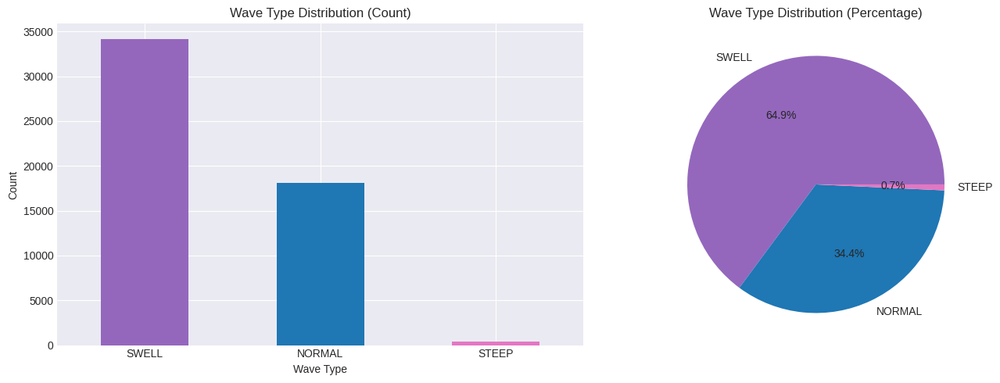

In [17]:
# Wave type distribution
if 'wave_type' in data.columns:
    wave_counts = data['wave_type'].value_counts()
    wave_pct = (wave_counts / len(data) * 100).round(2)
    
    print("Wave Type Distribution:")
    print("\nCount:")
    print(wave_counts)
    print("\nPercentage:")
    print(wave_pct)
    
    # Plot
    fig, ax = plt.subplots(1, 2, figsize=(14, 5))
    
    wave_counts.plot(kind='bar', ax=ax[0], color=['#9467bd', '#1f77b4', '#e377c2'])
    ax[0].set_title('Wave Type Distribution (Count)')
    ax[0].set_xlabel('Wave Type')
    ax[0].set_ylabel('Count')
    ax[0].tick_params(axis='x', rotation=0)
    
    wave_pct.plot(kind='pie', ax=ax[1], autopct='%1.1f%%', 
                  colors=['#9467bd', '#1f77b4', '#e377c2'])
    ax[1].set_title('Wave Type Distribution (Percentage)')
    ax[1].set_ylabel('')
    
    plt.tight_layout()
    plt.show()

## 7. Export Processed Data

In [18]:
# Create output formats
wide_df, long_df = processor.create_output_formats(data, station)

# Save to CSV
output_dir = '../data/processed'
import os
os.makedirs(output_dir, exist_ok=True)

wide_df.to_csv(f'{output_dir}/ndbc_{station}_wide.csv')
long_df.to_csv(f'{output_dir}/ndbc_{station}_long.csv', index=False)

print(f"Data saved to {output_dir}/")
print(f"  - Wide format: ndbc_{station}_wide.csv")
print(f"  - Long format: ndbc_{station}_long.csv")

Data saved to ../data/processed/
  - Wide format: ndbc_44013_wide.csv
  - Long format: ndbc_44013_long.csv


## 8. Summary Dashboard

In [19]:
# Create comprehensive summary figure
summary_fig = create_summary_figure(data, station)
summary_fig.show()

## Conclusion

This notebook demonstrated:
- Data loading from NOAA/NDBC stations
- Comprehensive data cleaning and quality control
- Derived parameter calculation (steepness, wave types)
- Multiple visualization techniques
- Storm event detection and analysis
- Spectral analysis using FFT
- Seasonal pattern identification

### Next Steps:
1. Run the Streamlit dashboard: `streamlit run ../app.py`
2. Compare multiple stations
3. Perform long-term trend analysis
4. Integrate with weather data for correlation studies